<a href="https://colab.research.google.com/github/SebastianOuslis/Cocktail-Party-Audio-Processing-Python/blob/main/Sebastian_Ouslis_313_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Sebastian Ouslis

THE COCKTAIL FORK PROBLEM:
THREE-STEM AUDIO SEPARATION FOR REAL-WORLD SOUNDTRACKS

---

Problem Formulation: 

The Cocktail Party problem is a challenge for computers to be able to isolate any source of interest within a complex acoustic scene. It is called the cocktail party problem because it is similar to if you were at a party where multiple conversations or sounds were occuring at the same time and you wanted to listen to one. This is very easy for humans to do but it is more difficult for computers.


This paper theorises a new problem where three audio sources are combined together: music, speech, and sound fx (ambient noise and natural sounds).

The paper is a report explaining how to make a dataset for this problem using the following datasets: LibriVox (speech), FSD50K (SFX), and FMA (music)

---
Proposed Solution:

Step 1: Grab the Datasets

Step 2: Convert datasets to the same file type (WAV)

Step 3: Normalize loudness based on audio type

Step 4: Resample audio to same sampling rate

Step 5 (Optional): Append short audio clips to themselves to take up more time in the audio

Step 6: Combine audio clips

---
Datasets (Warning they are very big) :


FSD50K  --  https://zenodo.org/record/4060432#.YTkaoN8pBPY


FMA-Medium Set  --  https://github.com/mdeff/fma


LibriSpeech/LibriVox  --  https://www.openslr.org/12  

---







In [ ]:
!pip install numpy

!pip install soundfile

!pip install git+https://github.com/csteinmetz1/pyloudnorm

!pip install scipy

!pip install pydub 

!pip install librosa

!pip install pyloudnorm

!pip install matplotlib

  Cloning https://github.com/csteinmetz1/pyloudnorm to /tmp/pip-req-build-v4uf7fjs
  Running command git clone -q https://github.com/csteinmetz1/pyloudnorm /tmp/pip-req-build-v4uf7fjs


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Files used in the solution (any file from each dataset can be used):

**Example 1**

Speech:

Clean Speech Files -> dev-clean -> 1272 -> 128104 -> 1272-128104-0000.flac

/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/Clean Speech Files/dev-clean/1272/128104/1272-128104-0000.flac

Music:

fma small -> 000 -> 000002.mp3

/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/fma small/000/000002.mp3

Audio Fx:

FSD DEV Files -> 143182.wav


/content/drive/MyDrive/Wav File Move/143182.wav


**Example 2**

Speech:

Clean Speech Files -> dev-clean -> 6241 -> 66616 -> 6241-66616-0025.flac

/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/Clean Speech Files/dev-clean/6241/66616/6241-66616-0025.flac

Music:

fma small -> 006 -> 006390.mp3

/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/fma small/006/006390.mp3

Audio Fx:

FSD DEV Files -> 372542.wav


/content/drive/MyDrive/Wav File Move/372542.wav





In [ ]:
#convert mp3 and flac files to wav

from pydub import AudioSegment

example_1_music_file_mp3 = r"/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/fma small/000/000002.mp3"
example_1_music_file_wav = r"/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/fma small/000/000002.wav"

example_1_speech_file_flac = r"/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/Clean Speech Files/dev-clean/1272/128104/1272-128104-0000.flac"
example_1_speech_file_wav = r"/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/Clean Speech Files/dev-clean/1272/128104/1272-128104-0000.wav"


example_2_music_file_mp3 = r"/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/fma small/006/006390.mp3"
example_2_music_file_wav = r"/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/fma small/006/006390.wav"

example_2_speech_file_flac = r"/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/Clean Speech Files/dev-clean/6241/66616/6241-66616-0025.flac"
example_2_speech_file_wav = r"/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/Clean Speech Files/dev-clean/6241/66616/6241-66616-0025.wav"


#Example 1

sound = AudioSegment.from_mp3(example_1_music_file_mp3)
sound.export(example_1_music_file_wav, format="wav")

sound2 = AudioSegment.from_file(example_1_speech_file_flac)
sound2.export(example_1_speech_file_wav, format="wav");

#Example 2

sound = AudioSegment.from_mp3(example_2_music_file_mp3)
sound.export(example_2_music_file_wav, format="wav")

sound2 = AudioSegment.from_file(example_2_speech_file_flac)
sound2.export(example_2_speech_file_wav, format="wav");



Target Loudness in LUFS (the more negative a number, the quieter it is):

Music -> -24

Speech -> -17

Sound FX Foreground -> -21

Sound FX Background -> -29

**The following code prepares the files for processing by normalizing the volume levels**

In [ ]:
import soundfile as sf
import pyloudnorm as pyln

import warnings
warnings.filterwarnings("ignore")
# Example 1

example_1_combined_output_path_non_repeated = r"/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/finished files/example_1_combined_audio_file_not_repeated.wav"
example_1_combined_output_path_repeated = r"/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/finished files/example_1_combined_audio_file_repeated.wav"

example_1_fx_file_wav = r"/content/drive/MyDrive/Wav File Move/143182.wav"
example_1_speech_file_wav = r"/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/Clean Speech Files/dev-clean/1272/128104/1272-128104-0000.wav"
example_1_music_file_wav = r"/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/fma small/000/000002.wav"

example_1_fx_file_wav_normalized = r"/content/drive/MyDrive/Wav File Move/143182_normalized.wav"
example_1_speech_file_wav_normalized = r"/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/Clean Speech Files/dev-clean/1272/128104/1272-128104-0000_normalized.wav"
example_1_music_file_wav_normalized = r"/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/fma small/000/000002_normalized.wav"


data_1, rate_1 = sf.read(example_1_fx_file_wav) # fx
data_2, rate_2 = sf.read(example_1_music_file_wav) # music
data_3, rate_3 = sf.read(example_1_speech_file_wav) # speech

target_1 = -21

target_2 = -24

target_3 = -17

meter_1 = pyln.Meter(rate_1) # create BS.1770 meter
loudness_1 = meter_1.integrated_loudness(data_1) # measure loudness

meter_2 = pyln.Meter(rate_2) # create BS.1770 meter
loudness_2 = meter_2.integrated_loudness(data_2) # measure loudness

meter_3 = pyln.Meter(rate_3) # create BS.1770 meter
loudness_3 = meter_3.integrated_loudness(data_3) # measure loudness

print("Example 1")
print("music loudness is: "+ str(loudness_2)  + "  -----  target is: " + str(target_2) )
print("fx loudness is: "+ str(loudness_1)  + "  -----  target is: " + str(target_1) )
print("speech loudness is: "+ str(loudness_3) + "  -----  target is: " + str(target_3) )

# loudness normalize audio
loudness_normalized_audio_1 = pyln.normalize.loudness(data_1, loudness_1, target_1)
loudness_normalized_audio_2 = pyln.normalize.loudness(data_2, loudness_2, target_2)
loudness_normalized_audio_3 = pyln.normalize.loudness(data_3, loudness_3, target_3)

sf.write(example_1_fx_file_wav_normalized, loudness_normalized_audio_1, rate_1)
sf.write(example_1_music_file_wav_normalized, loudness_normalized_audio_2, rate_2)
sf.write(example_1_speech_file_wav_normalized, loudness_normalized_audio_3, rate_3)

#Example 2

example_2_combined_output_path_non_repeated = r"/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/finished files/example_2_combined_audio_file_not_repeated.wav"
example_2_combined_output_path_repeated = r"/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/finished files/example_2_combined_audio_file_repeated.wav"

example_2_fx_file_wav = r"/content/drive/MyDrive/Wav File Move/372542.wav"
example_2_speech_file_wav = r"/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/Clean Speech Files/dev-clean/6241/66616/6241-66616-0025.wav"
example_2_music_file_wav = r"/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/fma small/006/006390.wav"

example_2_fx_file_wav_normalized = r"/content/drive/MyDrive/Wav File Move/372542_normalized.wav"
example_2_speech_file_wav_normalized = r"/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/Clean Speech Files/dev-clean/6241/66616/6241-66616-0025_normalized.wav"
example_2_music_file_wav_normalized = r"/content/drive/MyDrive/Sebastian ECE313 Audio Source Files/fma small/006/006390_normalized.wav"

data_1, rate_1 = sf.read(example_2_fx_file_wav); # fx
data_2, rate_2 = sf.read(example_2_music_file_wav); # music
data_3, rate_3 = sf.read(example_2_speech_file_wav); # speech

target_1 = -21

target_2 = -24

target_3 = -17

meter_1 = pyln.Meter(rate_1) # create BS.1770 meter
loudness_1 = meter_1.integrated_loudness(data_1) # measure loudness

meter_2 = pyln.Meter(rate_2) # create BS.1770 meter
loudness_2 = meter_2.integrated_loudness(data_2) # measure loudness

meter_3 = pyln.Meter(rate_3) # create BS.1770 meter
loudness_3 = meter_3.integrated_loudness(data_3) # measure loudness

print("----")
print("Example 2")

print("music loudness is: "+ str(loudness_2)  + "  -----  target is: " + str(target_2) )
print("fx loudness is: "+ str(loudness_1)  + "  -----  target is: " + str(target_1) )
print("speech loudness is: "+ str(loudness_3) + "  -----  target is: " + str(target_3) )

# loudness normalize audio
loudness_normalized_audio_1 = pyln.normalize.loudness(data_1, loudness_1, target_1);
loudness_normalized_audio_2 = pyln.normalize.loudness(data_2, loudness_2, target_2);
loudness_normalized_audio_3 = pyln.normalize.loudness(data_3, loudness_3, target_3);

sf.write(example_2_fx_file_wav_normalized, loudness_normalized_audio_1, rate_1);
sf.write(example_2_music_file_wav_normalized, loudness_normalized_audio_2, rate_2);
sf.write(example_2_speech_file_wav_normalized, loudness_normalized_audio_3, rate_3);


Example 1
music loudness is: -13.162197209685193  -----  target is: -24
fx loudness is: -20.308975997049213  -----  target is: -21
speech loudness is: -23.661658433539664  -----  target is: -17
----
Example 2
music loudness is: -14.82374590321451  -----  target is: -24
fx loudness is: -32.341498168863005  -----  target is: -21
speech loudness is: -23.986646919061986  -----  target is: -17


**Look and listen to the audio data before its combined!**

**Example 1**

Music File Original


Music File Normalized


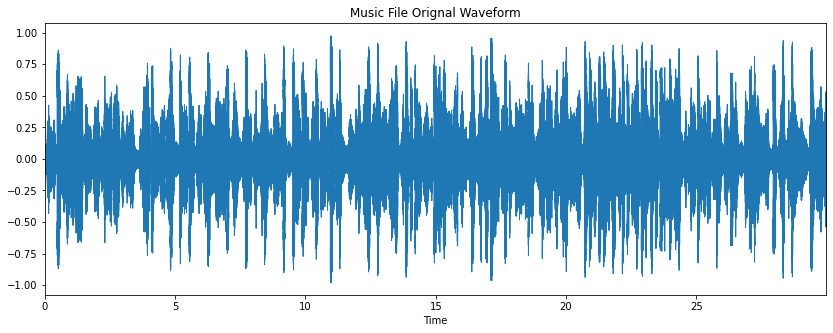

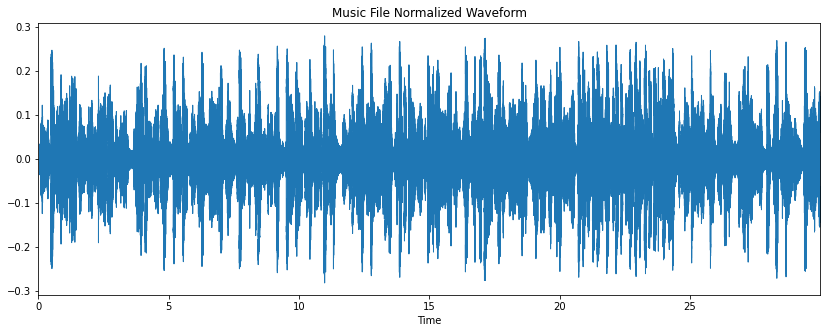

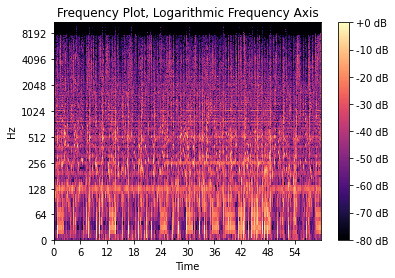

In [ ]:
import numpy as np
import librosa
from scipy.io import wavfile

import IPython.display as ipd

import copy

%matplotlib inline
import matplotlib.pyplot as plt
import librosa.display


data1, fs1 = librosa.load(example_1_music_file_wav, sr=44100 )
data1_2, fs1 = librosa.load(example_1_music_file_wav_normalized, sr=44100 )

print("Music File Original")
#prevents audio normalization when played
data1[-1] = 1 
ipd.display(ipd.Audio(data1, rate=fs1))

print("Music File Normalized")
data1_2[-1] = 1 
ipd.display(ipd.Audio(data1_2, rate=fs1))

plt.figure(figsize=(14, 5))
plt.title('Music File Orignal Waveform')
librosa.display.waveplot(data1, sr=fs1);

plt.figure(figsize=(14, 5))
plt.title('Music File Normalized Waveform')
librosa.display.waveplot(data1_2, sr=fs1);

fft_data = librosa.stft(data1)
S_db = librosa.amplitude_to_db(np.abs(fft_data), ref=np.max)

fig, ax = plt.subplots()
img = librosa.display.specshow(S_db, x_axis='time', y_axis='log', ax=ax)
ax.set(title='Frequency Plot, Logarithmic Frequency Axis')
fig.colorbar(img, ax=ax, format="%+2.f dB");


Sound FX File Original


Sound FX File Normalized


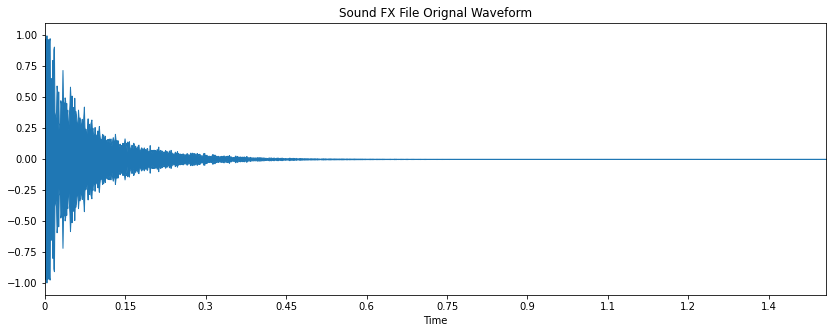

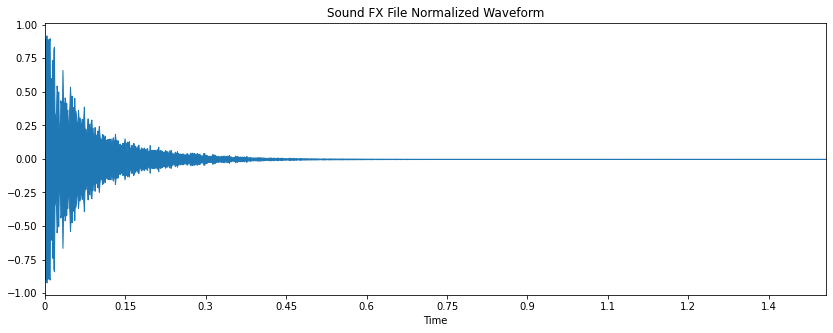

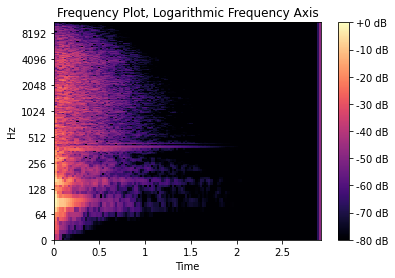

In [ ]:
data2, fs2 = librosa.load(example_1_fx_file_wav, sr=44100 )
data2_2, fs2 = librosa.load(example_1_fx_file_wav_normalized, sr=44100 )

print("Sound FX File Original")
data2[-1] = 1 
ipd.display(ipd.Audio(data2, rate=fs1))

print("Sound FX File Normalized")
data2_2[-1] = 1 
ipd.display(ipd.Audio(data2_2, rate=fs1))

plt.figure(figsize=(14, 5))
plt.title('Sound FX File Orignal Waveform')
librosa.display.waveplot(data2, sr=fs1);

plt.figure(figsize=(14, 5))
plt.title('Sound FX File Normalized Waveform')
librosa.display.waveplot(data2_2, sr=fs1);

fft_data = librosa.stft(data2)
S_db = librosa.amplitude_to_db(np.abs(fft_data), ref=np.max)

fig, ax = plt.subplots()
img = librosa.display.specshow(S_db, x_axis='time', y_axis='log', ax=ax)
ax.set(title='Frequency Plot, Logarithmic Frequency Axis')
fig.colorbar(img, ax=ax, format="%+2.f dB");

Speech File Original


Speech File Normalized


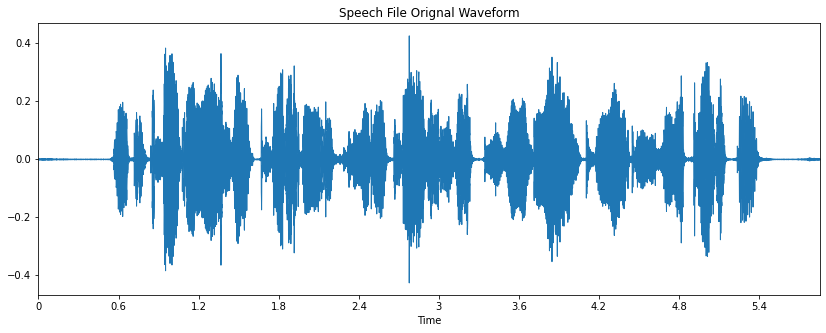

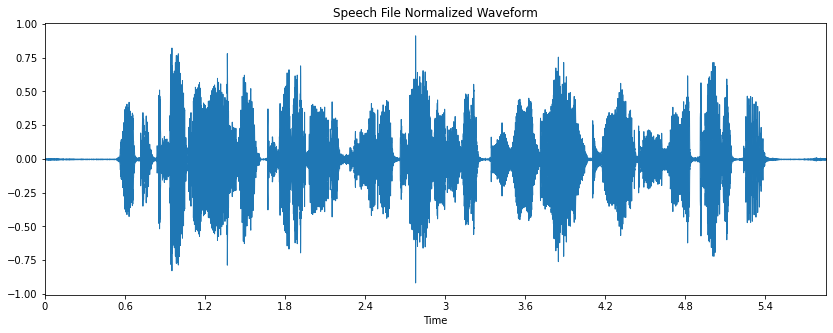

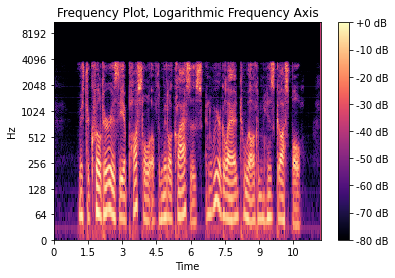

In [ ]:
data3, fs3 = librosa.load(example_1_speech_file_wav, sr=44100 )
data3_2, fs3 = librosa.load(example_1_speech_file_wav_normalized, sr=44100 )

print("Speech File Original")
data3[-1] = 1 
ipd.display(ipd.Audio(data3, rate=fs1))

print("Speech File Normalized")
data3_2[-1] = 1
ipd.display(ipd.Audio(data3_2, rate=fs1))

plt.figure(figsize=(14, 5))
plt.title('Speech File Orignal Waveform')
librosa.display.waveplot(data3, sr=fs1);

plt.figure(figsize=(14, 5))
plt.title('Speech File Normalized Waveform')
librosa.display.waveplot(data3_2, sr=fs1);

fft_data = librosa.stft(data3)
S_db = librosa.amplitude_to_db(np.abs(fft_data), ref=np.max)

fig, ax = plt.subplots()
img = librosa.display.specshow(S_db, x_axis='time', y_axis='log', ax=ax)
ax.set(title='Frequency Plot, Logarithmic Frequency Axis')
fig.colorbar(img, ax=ax, format="%+2.f dB");


Combined Audio - Non Repeated Speech and FX 


Combined Audio - Repeated Speech and FX 


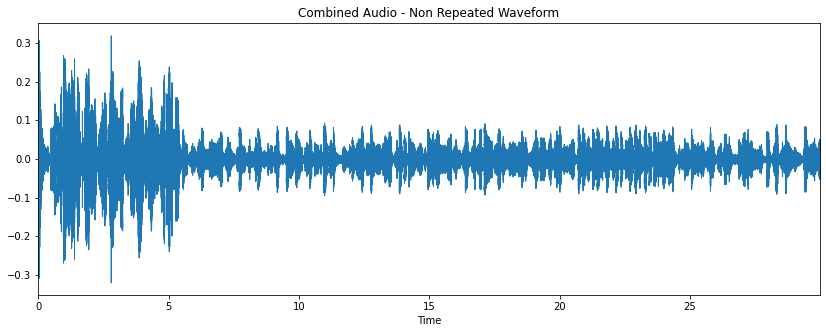

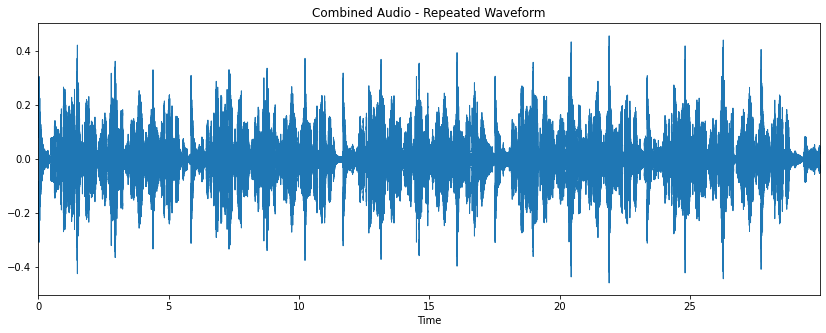

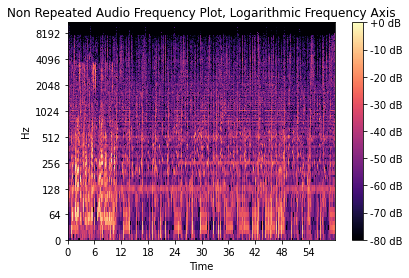

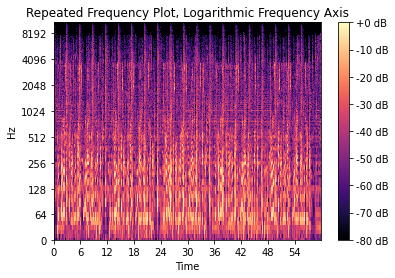

In [ ]:
#combine files together into one audio signal

data1, fs1 = librosa.load(example_1_music_file_wav_normalized, sr=44100 )
data2, fs2 = librosa.load(example_1_fx_file_wav_normalized, sr=44100 )
data3, fs3 = librosa.load(example_1_speech_file_wav_normalized, sr=44100 )

max_len = data1
data1_multiple = 1
data2_multiple = int(len(data1)/len(data2))
data3_multiple = int(len(data1)/len(data3))

if len(data2) > len(max_len):
  max_len = data2
  data1_multiple = int(len(data2)/len(data1))
  data2_multiple = 1
  data3_multiple = int(len(data2)/len(data3))

if len(data3) > len(max_len):
  max_len = data3
  data1_multiple = int(len(data3)/len(data1))
  data2_multiple = int(len(data3)/len(data2))
  data3_multiple = 1

data_music = copy.deepcopy(data1)
data_fx = copy.deepcopy(data2)
data_voice = copy.deepcopy(data3)

data1_multiple = data1_multiple-1
data2_multiple = data2_multiple-1
data3_multiple = data3_multiple-1

data_music_copy = copy.deepcopy(data_music)
data_fx_copy = copy.deepcopy(data_fx)
data_voice_copy = copy.deepcopy(data_voice)

for i in range(data1_multiple):
  data_music_copy = np.append(data_music_copy, data_music)

for i in range(data2_multiple):
  data_fx_copy = np.append(data_fx_copy, data_fx)

for i in range(data3_multiple):
  data_voice_copy = np.append(data_voice_copy, data_voice)

data_music.resize( max_len.shape, refcheck=False )

data_fx.resize( max_len.shape, refcheck=False )

data_voice.resize( max_len.shape, refcheck=False )

data_music_copy.resize( max_len.shape, refcheck=False )

data_fx_copy.resize( max_len.shape, refcheck=False )

data_voice_copy.resize( max_len.shape, refcheck=False )

result_not_repeated = (1/3) * data_music + (1/3) * data_fx + (1/3) * data_voice
result_repeated = (1/3) * data_music_copy + (1/3) * data_fx_copy + (1/3) * data_voice_copy



#combined audio files
wavfile.write(example_1_combined_output_path_repeated, fs1, result_repeated)

wavfile.write(example_1_combined_output_path_non_repeated, fs1, result_not_repeated)

print("Combined Audio - Non Repeated Speech and FX ")
result_not_repeated[-1] = 1 
ipd.display(ipd.Audio(result_not_repeated, rate=fs1))

fft_data = librosa.stft(result_not_repeated)
S_db = librosa.amplitude_to_db(np.abs(fft_data), ref=np.max)

plt.figure(figsize=(14, 5))
plt.title('Combined Audio - Non Repeated Waveform')
librosa.display.waveplot(result_not_repeated, sr=fs1);

plt.figure(figsize=(14, 5))
plt.title('Combined Audio - Repeated Waveform')
librosa.display.waveplot(result_repeated, sr=fs1);

fig, ax = plt.subplots()
img = librosa.display.specshow(S_db, x_axis='time', y_axis='log', ax=ax);
ax.set(title='Non Repeated Audio Frequency Plot, Logarithmic Frequency Axis')
fig.colorbar(img, ax=ax, format="%+2.f dB");

print("Combined Audio - Repeated Speech and FX ")
result_repeated[-1] = 1 
ipd.display(ipd.Audio(result_repeated, rate=fs1))

fft_data = librosa.stft(result_repeated)
S_db = librosa.amplitude_to_db(np.abs(fft_data), ref=np.max)

fig, ax = plt.subplots()
img = librosa.display.specshow(S_db, x_axis='time', y_axis='log', ax=ax);
ax.set(title='Repeated Frequency Plot, Logarithmic Frequency Axis')
fig.colorbar(img, ax=ax, format="%+2.f dB");


**Example 2**

Music File Original


Music File Normalized


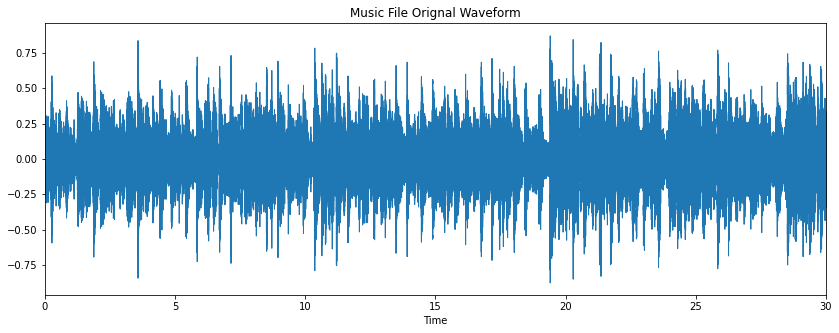

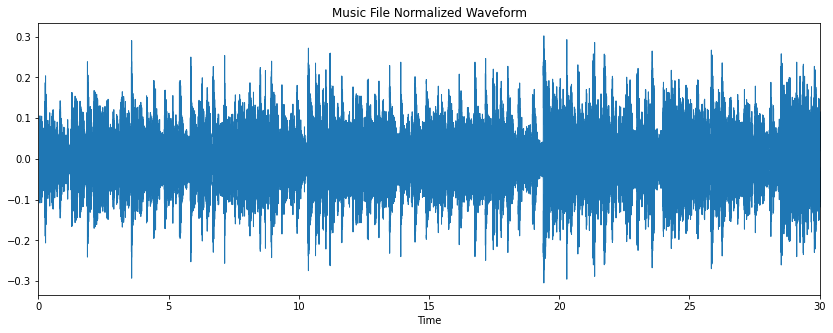

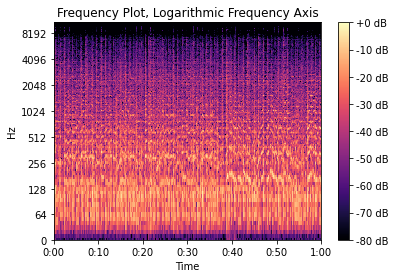

In [ ]:
import numpy as np
import librosa
from scipy.io import wavfile

import IPython.display as ipd

import copy

%matplotlib inline
import matplotlib.pyplot as plt
import librosa.display


data1, fs1 = librosa.load(example_2_music_file_wav, sr=44100 )
data1_2, fs1 = librosa.load(example_2_music_file_wav_normalized, sr=44100 )

print("Music File Original")
data1[-1] = 1 
ipd.display(ipd.Audio(data1, rate=fs1))

print("Music File Normalized")
data1_2[-1] = 1 
ipd.display(ipd.Audio(data1_2, rate=fs1))

plt.figure(figsize=(14, 5))
plt.title('Music File Orignal Waveform')
librosa.display.waveplot(data1, sr=fs1);

plt.figure(figsize=(14, 5))
plt.title('Music File Normalized Waveform')
librosa.display.waveplot(data1_2, sr=fs1);

fft_data = librosa.stft(data1)
S_db = librosa.amplitude_to_db(np.abs(fft_data), ref=np.max)

fig, ax = plt.subplots()
img = librosa.display.specshow(S_db, x_axis='time', y_axis='log', ax=ax)
ax.set(title='Frequency Plot, Logarithmic Frequency Axis')
fig.colorbar(img, ax=ax, format="%+2.f dB");

Sound FX File Original


Sound FX File Normalized


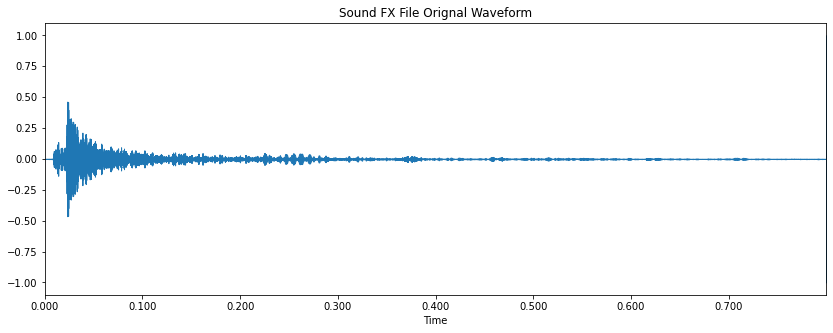

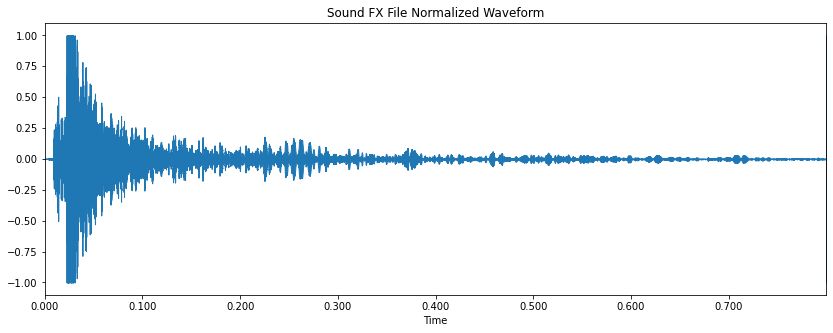

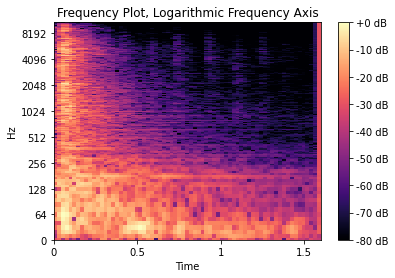

In [ ]:
data2, fs2 = librosa.load(example_2_fx_file_wav, sr=44100 )
data2_2, fs2 = librosa.load(example_2_fx_file_wav_normalized, sr=44100 )

print("Sound FX File Original")
data2[-1] = 1 
ipd.display(ipd.Audio(data2, rate=fs1))

print("Sound FX File Normalized")
data2_2[-1] = 1 
ipd.display(ipd.Audio(data2_2, rate=fs1))

plt.figure(figsize=(14, 5))
plt.title('Sound FX File Orignal Waveform')
librosa.display.waveplot(data2, sr=fs1);

plt.figure(figsize=(14, 5))
plt.title('Sound FX File Normalized Waveform')
librosa.display.waveplot(data2_2, sr=fs1);

fft_data = librosa.stft(data2)
S_db = librosa.amplitude_to_db(np.abs(fft_data), ref=np.max)

fig, ax = plt.subplots()
img = librosa.display.specshow(S_db, x_axis='time', y_axis='log', ax=ax)
ax.set(title='Frequency Plot, Logarithmic Frequency Axis')
fig.colorbar(img, ax=ax, format="%+2.f dB");

Speech File Original


Speech File Normalized


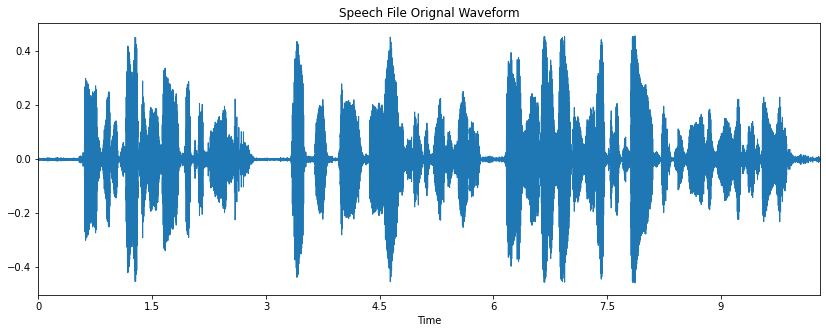

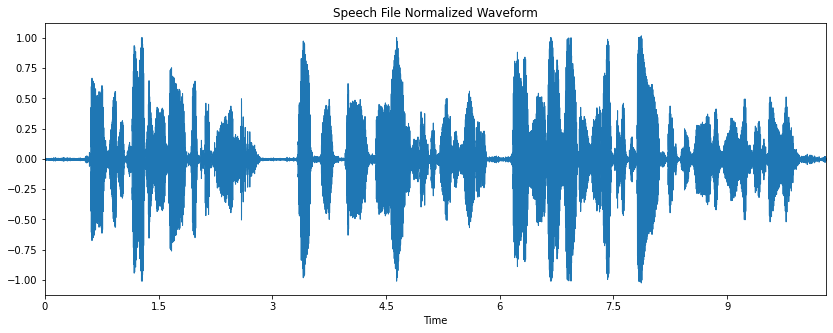

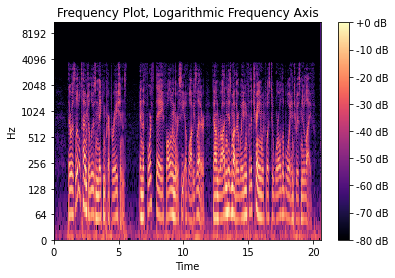

In [ ]:
data3, fs3 = librosa.load(example_2_speech_file_wav, sr=44100 )
data3_2, fs3 = librosa.load(example_2_speech_file_wav_normalized, sr=44100 )

print("Speech File Original")
data3[-1] = 1 
ipd.display(ipd.Audio(data3, rate=fs1))

print("Speech File Normalized")
data3_2[-1] = 1 
ipd.display(ipd.Audio(data3_2, rate=fs1))

plt.figure(figsize=(14, 5))
plt.title('Speech File Orignal Waveform')
librosa.display.waveplot(data3, sr=fs1);

plt.figure(figsize=(14, 5))
plt.title('Speech File Normalized Waveform')
librosa.display.waveplot(data3_2, sr=fs1);

fft_data = librosa.stft(data3)
S_db = librosa.amplitude_to_db(np.abs(fft_data), ref=np.max)

fig, ax = plt.subplots()
img = librosa.display.specshow(S_db, x_axis='time', y_axis='log', ax=ax)
ax.set(title='Frequency Plot, Logarithmic Frequency Axis')
fig.colorbar(img, ax=ax, format="%+2.f dB");


Combined Audio - Non Repeated Speech and FX 


Combined Audio - Repeated Speech and FX 


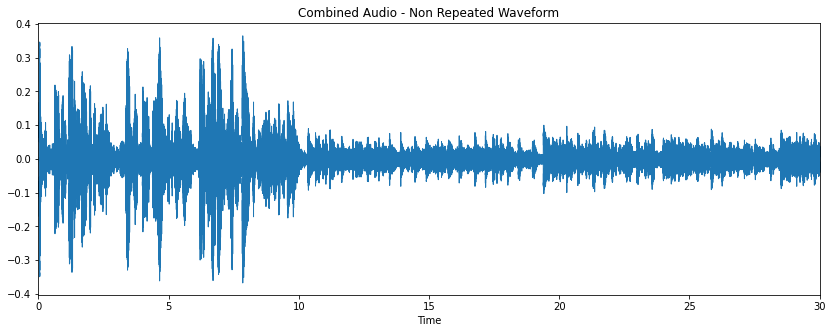

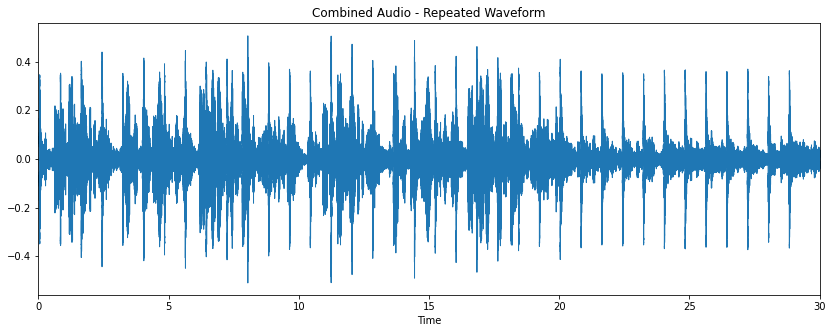

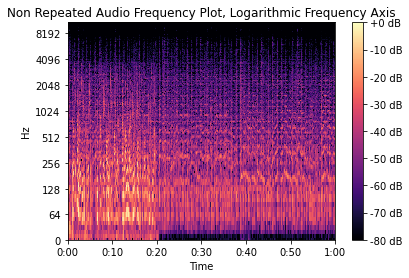

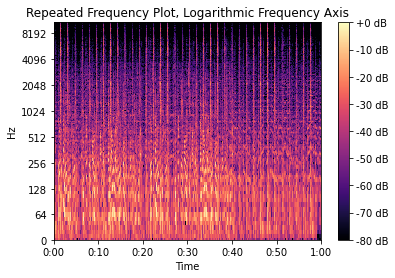

In [ ]:
#combine files together into one audio signal

data1, fs1 = librosa.load(example_2_music_file_wav_normalized, sr=44100 )
data2, fs2 = librosa.load(example_2_fx_file_wav_normalized, sr=44100 )
data3, fs3 = librosa.load(example_2_speech_file_wav_normalized, sr=44100 )

max_len = data1
data1_multiple = 1
data2_multiple = int(len(data1)/len(data2))
data3_multiple = int(len(data1)/len(data3))

if len(data2) > len(max_len):
  max_len = data2
  data1_multiple = int(len(data2)/len(data1))
  data2_multiple = 1
  data3_multiple = int(len(data2)/len(data3))

if len(data3) > len(max_len):
  max_len = data3
  data1_multiple = int(len(data3)/len(data1))
  data2_multiple = int(len(data3)/len(data2))
  data3_multiple = 1

data_music = copy.deepcopy(data1)
data_fx = copy.deepcopy(data2)
data_voice = copy.deepcopy(data3)

data1_multiple = data1_multiple-1
data2_multiple = data2_multiple-1
data3_multiple = data3_multiple-1

data_music_copy = copy.deepcopy(data_music)
data_fx_copy = copy.deepcopy(data_fx)
data_voice_copy = copy.deepcopy(data_voice)

for i in range(data1_multiple):
  data_music_copy = np.append(data_music_copy, data_music)

for i in range(data2_multiple):
  data_fx_copy = np.append(data_fx_copy, data_fx)

for i in range(data3_multiple):
  data_voice_copy = np.append(data_voice_copy, data_voice)

data_music.resize( max_len.shape, refcheck=False )

data_fx.resize( max_len.shape, refcheck=False )

data_voice.resize( max_len.shape, refcheck=False )

data_music_copy.resize( max_len.shape, refcheck=False )

data_fx_copy.resize( max_len.shape, refcheck=False )

data_voice_copy.resize( max_len.shape, refcheck=False )

result_not_repeated = (1/3) * data_music + (1/3) * data_fx + (1/3) * data_voice
result_repeated = (1/3) * data_music_copy + (1/3) * data_fx_copy + (1/3) * data_voice_copy



#combined audio files
wavfile.write(example_2_combined_output_path_repeated, fs1, result_repeated)

wavfile.write(example_2_combined_output_path_non_repeated, fs1, result_not_repeated)

print("Combined Audio - Non Repeated Speech and FX ")
result_not_repeated[-1] = 1 
ipd.display(ipd.Audio(result_not_repeated, rate=fs1))

fft_data = librosa.stft(result_not_repeated)
S_db = librosa.amplitude_to_db(np.abs(fft_data), ref=np.max)

plt.figure(figsize=(14, 5))
plt.title('Combined Audio - Non Repeated Waveform')
librosa.display.waveplot(result_not_repeated, sr=fs1);

plt.figure(figsize=(14, 5))
plt.title('Combined Audio - Repeated Waveform')
librosa.display.waveplot(result_repeated, sr=fs1);

fig, ax = plt.subplots()
img = librosa.display.specshow(S_db, x_axis='time', y_axis='log', ax=ax);
ax.set(title='Non Repeated Audio Frequency Plot, Logarithmic Frequency Axis')
fig.colorbar(img, ax=ax, format="%+2.f dB");

print("Combined Audio - Repeated Speech and FX ")
result_repeated[-1] = 1 
ipd.display(ipd.Audio(result_repeated, rate=fs1))

fft_data = librosa.stft(result_repeated)
S_db = librosa.amplitude_to_db(np.abs(fft_data), ref=np.max)

fig, ax = plt.subplots()
img = librosa.display.specshow(S_db, x_axis='time', y_axis='log', ax=ax);
ax.set(title='Repeated Frequency Plot, Logarithmic Frequency Axis')
fig.colorbar(img, ax=ax, format="%+2.f dB");

Analysis of Results

--- 
Have you been able to reproduce the results reported in the original
paper? 

Yes the results have been reproduced. The final combined audio file has each component audible.

Did the algorithm behave in a predictable way, i.e., as described by the authors? 

The algorithm was predictable unless the sounds were very short. The repeated audio section was added to add variation so that the sound fx would not only play at the begining.


Do your own conclusions support those made by the authors? 

I do agree that the audio dataset is a good one to train with. If I had more time and machine learning skill, I would train an alghorithm using the created dataset to see how good it is at splitting the combined audio files.

What are the drawbacks (if any) of the proposed solution?

The drawbacks would be that the sound effects do not occur at random intervals. An improvment would be to adjust when the sound effects or speech occur in order to improve the training data set so that a machine learning alghorithm would have a dataset that is more reflective of real life data.

In [ ]:
%%shell
jupyter nbconvert --to html /content/Sebastian_Ouslis_313_Project.ipynb

[NbConvertApp] Converting notebook /content/Sebastian_Ouslis_313_Project.ipynb to html
[NbConvertApp] Writing 35055796 bytes to /content/Sebastian_Ouslis_313_Project.html
